# Install Dependencies

In [1]:
# Install dependencies
!pip install pretty_midi librosa torch torchvision torchaudio transformers datasets
!pip install kaggle


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 37.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 80.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 44.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 39.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 188.7/188.7 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 65.9 MB/s eta 0:00:00
   

In [9]:
!pip install kaggle
!kaggle datasets download -d blanderbuss/midi-classic-music
!unzip midi-classic-music.zip -d ./midi_data

Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 10, in <module>
    sys.exit(main())
             ^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/kaggle/cli.py", line 68, in main
    out = args.func(**command_args)
          ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/kaggle/api/kaggle_api_extended.py", line 1741, in dataset_download_cli
    with self.build_kaggle_client() as kaggle:
         ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/kaggle/api/kaggle_api_extended.py", line 688, in build_kaggle_client
    username=self.config_values['username'],
             ~~~~~~~~~~~~~~~~~~^^^^^^^^^^^^
KeyError: 'username'
unzip:  cannot find or open midi-classic-music.zip, midi-classic-music.zip.zip or midi-classic-music.zip.ZIP.


Importing necessary Libraries

In [2]:
!Pip install optuna

/bin/bash: line 1: Pip: command not found


Preprocessing

https://www.kaggle.com/datasets/blanderbuss/midi-classic-music

In [30]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("blanderbuss/midi-classic-music")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/midi-classic-music


Confirming midifiles

In [22]:
import os

# Replace with actual path if needed
midi_dir = path

# List contents
print("Top-level contents:", os.listdir(midi_dir))

# Recursively find .mid files
midi_files = []
for root, _, files in os.walk(midi_dir):
    for file in files:
        if file.endswith(".mid"):
            midi_files.append(os.path.join(root, file))

print(f"Found {len(midi_files)} MIDI files.")

Top-level contents: ['Alkan', 'Albéniz', 'Arensky', 'midiclassics.zip', 'Rothchild Symphony Rmw12 2mov.mid', 'Tchaikovsky Lake Of The Swans Act 1 5mov.mid', 'Tchaikovsky Lake Of The Swans Act 2 10mov.mid', 'Tchaikovsky Lake Of The Swans Act 1 1mov.mid', 'Tchaikovsky Lake Of The Swans Act 1 4mov.mid', 'Tchaicovsky Waltz of the Flowers.MID', 'Tchaikovsky Lake Of The Swans Act 1 2mov.mid', 'Tchaikovsky Lake Of The Swans Act 1 3mov.mid', 'Arndt', 'Rothchlid Symphony Rmw12 3mov.mid', 'Tchaikovsky Lake Of The Swans Act 2 11mov.mid', 'midiclassics', 'Wagner Ride of the valkyries.mid', 'Tchaikovsky Lake Of The Swans Act 1 6mov.mid', 'Tchaikovsky Lake Of The Swans Act 1 9mov.mid', 'Tchaikovsky Lake Of The Swans Act 1 7-8movs.mid', 'Sibelius Kuolema Vals op44.mid', 'Tchaikovsky Lake Of The Swans Act 2 12mov.mid', 'Tchaikovsky Lake Of The Swans Act 2 13mov.mid', 'Ambroise', 'Tchaikovsky Lake Of The Swans Act 2 14mov.mid']
Found 3979 MIDI files.


# Dataset

Restricting to only Bach, Beethoven, Chopin, Mozart per requirement

In [31]:
import os

# Replace with actual path returned by kagglehub
base_path = path
midi_root = os.path.join(base_path, "midiclassics")

target_composers = ["Bach", "Beethoven", "Chopin", "Mozart"]
composer_files = []

for composer in target_composers:
    composer_dir = os.path.join(midi_root, composer)
    if os.path.exists(composer_dir):
        for file in os.listdir(composer_dir):
            if file.endswith(".mid"):
                composer_files.append((os.path.join(composer_dir, file), composer))

print(f"Found {len(composer_files)} MIDI files from selected composers.")

Found 481 MIDI files from selected composers.


In [40]:
print(f"Found {len(midi_files)} MIDI files.")
print(f"Found {len(composer_files)} MIDI files from selected composers.")

Found 3979 MIDI files.
Found 481 MIDI files from selected composers.


# Load and visualize MIDI File

In [41]:
composer_to_label = {name: idx for idx, name in enumerate(target_composers)}
labeled_data = [(path, composer_to_label[composer]) for path, composer in composer_files]

In [42]:
sample_path, sample_composer = composer_files[0]
print(f"🎵 Composer: {sample_composer}")
piano_roll = midi_to_pianoroll(sample_path)
plot_piano_roll_plotly(piano_roll)

🎵 Composer: Bach


In [49]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import pretty_midi

# Sample inputs (replace with your actual data)
composer_list = ['Bach', 'Beethoven', 'Chopin', 'Mozart']
midi_paths = ['data/bach1.mid', 'data/beethoven1.mid', 'data/chopin1.mid',
              'data/mozart1.mid', 'data/bach2.mid', 'data/chopin2.mid', 'data/mozart2.mid']

In [53]:
import os

def collect_midi_metadata(root_dir):
    midi_paths = []
    composer_list = ['Bach', 'Beethoven', 'Chopin', 'Mozart']

    for composer in os.listdir(root_dir):
        composer_path = os.path.join(root_dir, composer)
        if os.path.isdir(composer_path):
            for dirpath, _, filenames in os.walk(composer_path):
                for file in filenames:
                    if file.lower().endswith('.mid'):
                        full_path = os.path.join(dirpath, file)
                        midi_paths.append(full_path)
                        composer_list.append(composer)
    return midi_paths, composer_list

In [74]:
def collect_midi_metadata(base_path, allowed_composers=None):
    midi_root = os.path.join(base_path, "midiclassics")
    midi_paths = []
    composer_list = []

    if allowed_composers is None:
        allowed_composers = ['Bach', 'Beethoven', 'Chopin', 'Mozart']

    for composer in os.listdir(midi_root):
        if composer not in allowed_composers:
            continue
        composer_path = os.path.join(midi_root, composer)
        if os.path.isdir(composer_path):
            for dirpath, _, filenames in os.walk(composer_path):
                for file in filenames:
                    if file.lower().endswith('.mid'):
                        full_path = os.path.join(dirpath, file)
                        midi_paths.append(full_path)
                        composer_list.append(composer)
    return midi_paths, composer_list

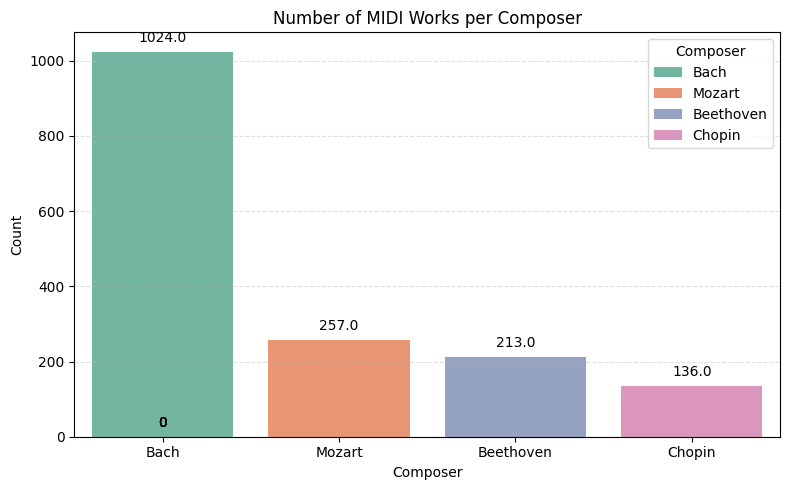

In [79]:
midi_paths, composer_list = collect_midi_metadata(base_path)

plot_work_count_seaborn(composer_list)



⚠️ Skipped 2 invalid MIDI files:
  - /kaggle/input/midi-classic-music/midiclassics/Mozart/Piano Sonatas/Nueva carpeta/K281 Piano Sonata n03 3mov.mid: Could not decode key with 2 flats and mode 2
  - /kaggle/input/midi-classic-music/midiclassics/Beethoven/Anhang 14-3.mid: Could not decode key with 3 flats and mode 255


/tmp/ipython-input-446219584.py:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




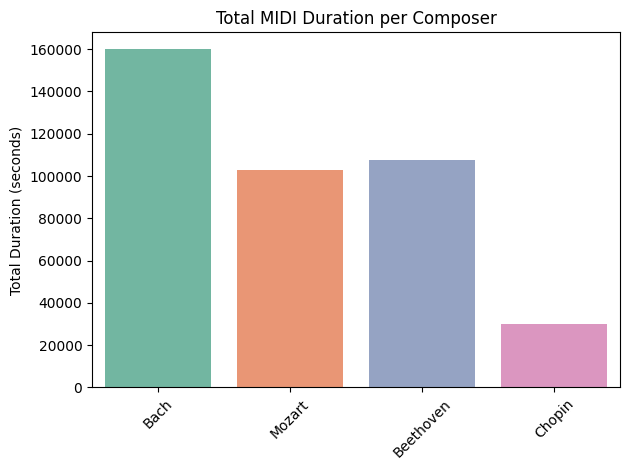

In [80]:
plot_total_duration_seaborn(midi_paths, composer_list)

In [84]:
from mido import MidiFile

def clean_midi(in_path, out_path):
    mid = MidiFile(in_path)
    for track in mid.tracks:
        track[:] = [msg for msg in track if not (msg.type == 'key_signature' and getattr(msg, 'mode', 0) not in [0, 1])]
    mid.save(out_path)

In [86]:
midi_root = os.path.join(base_path, "midiclassics")
clean_root = os.path.join("/kaggle/working", "midiclassics_cleaned")  # Use working dir for output

In [87]:
import os
from mido import MidiFile

def clean_midi(in_path, out_path):
    mid = MidiFile(in_path)
    for track in mid.tracks:
        track[:] = [msg for msg in track if not (msg.type == 'key_signature' and getattr(msg, 'mode', 0) not in [0, 1])]
    mid.save(out_path)

base_path = "/kaggle/input/midi-classic-music"
midi_root = os.path.join(base_path, "midiclassics")
clean_root = os.path.join("/kaggle/working", "midiclassics_cleaned")
os.makedirs(clean_root, exist_ok=True)

target_composers = ["Bach", "Beethoven", "Chopin", "Mozart"]
cleaned_files = []

for composer in target_composers:
    composer_dir = os.path.join(midi_root, composer)
    clean_dir = os.path.join(clean_root, composer)
    os.makedirs(clean_dir, exist_ok=True)

    if os.path.exists(composer_dir):
        for file in os.listdir(composer_dir):
            if file.endswith(".mid"):
                in_path = os.path.join(composer_dir, file)
                out_path = os.path.join(clean_dir, file)
                try:
                    clean_midi(in_path, out_path)
                    cleaned_files.append((out_path, composer))
                except Exception as e:
                    print(f"Failed to clean {file} from {composer}: {e}")

print(f"Successfully cleaned {len(cleaned_files)} MIDI files.")

Failed to clean Anhang 14-3.mid from Beethoven: Could not decode key with 3 flats and mode 255
Successfully cleaned 480 MIDI files.


In [90]:
from mido import MidiFile, MidiTrack

def clean_midi(in_path, out_path):
    try:
        mid = MidiFile(in_path)
    except Exception as e:
        print(f"Cannot load {in_path}: {e}")
        return False  # Skip this file

    for track in mid.tracks:
        track[:] = [msg for msg in track if msg.type != 'key_signature']
    mid.save(out_path)
    return True

In [91]:
file = "Anhang 14-3.mid"
composer = "Beethoven"
in_path = os.path.join(midi_root, composer, file)
out_path = os.path.join(clean_root, composer, file)

success = clean_midi(in_path, out_path)
if success:
    cleaned_files.append((out_path, composer))
    print(f"Successfully cleaned {file}")
else:
    print(f"Skipped {file} due to unrecoverable error.")

Cannot load /kaggle/input/midi-classic-music/midiclassics/Beethoven/Anhang 14-3.mid: Could not decode key with 3 flats and mode 255
Skipped Anhang 14-3.mid due to unrecoverable error.


In [92]:
import random
import pretty_midi

def swap_instruments(midi, swap_map=None):
    """
    Replace instrument programs in a MIDI file.
    If swap_map is None, randomly assign new programs.
    """
    new_midi = pretty_midi.PrettyMIDI()
    for inst in midi.instruments:
        new_inst = pretty_midi.Instrument(
            program=swap_map.get(inst.program, random.randint(0, 127)) if swap_map else random.randint(0, 127),
            is_drum=inst.is_drum,
            name=inst.name
        )
        new_inst.notes = inst.notes
        new_inst.control_changes = inst.control_changes
        new_inst.pitch_bends = inst.pitch_bends
        new_midi.instruments.append(new_inst)
    return new_midi

In [95]:
swap_map = {
    0: 40,   # Piano → Violin
    24: 0,   # Guitar → Piano
    48: 73,  # Strings → Flute
}
features = []
labels = []

In [96]:
for path, composer in cleaned_files:
    try:
        midi = pretty_midi.PrettyMIDI(path)

        # Original
        variants = [midi]

        # Augmented with instrument swap
        swapped = swap_instruments(midi)
        variants.append(swapped)

        for variant in variants:
            notes = [note for inst in variant.instruments for note in inst.notes]
            pitch_hist = np.histogram([n.pitch % 12 for n in notes], bins=12, range=(0,12))[0]
            velocity_mean = np.mean([n.velocity for n in notes])
            duration_mean = np.mean([n.end - n.start for n in notes])
            note_density = len(notes) / variant.get_end_time()
            feat = np.concatenate([pitch_hist, [velocity_mean, duration_mean, note_density]])
            features.append(feat)
            labels.append(composer)

    except Exception as e:
        print(f"Failed to augment {path}: {e}")

In [97]:
import numpy as np

X = np.array(features)
y = np.array(labels)

print("Feature matrix shape:", X.shape)
print("Number of samples:", len(y))
print("Unique composers:", set(y))

Feature matrix shape: (960, 15)
Number of samples: 960
Unique composers: {np.str_('Mozart'), np.str_('Beethoven'), np.str_('Chopin'), np.str_('Bach')}


/tmp/ipython-input-3605185.py:24: UserWarning:

Glyph 127932 (\N{MUSICAL SCORE}) missing from font(s) DejaVu Sans.

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 127932 (\N{MUSICAL SCORE}) missing from font(s) DejaVu Sans.



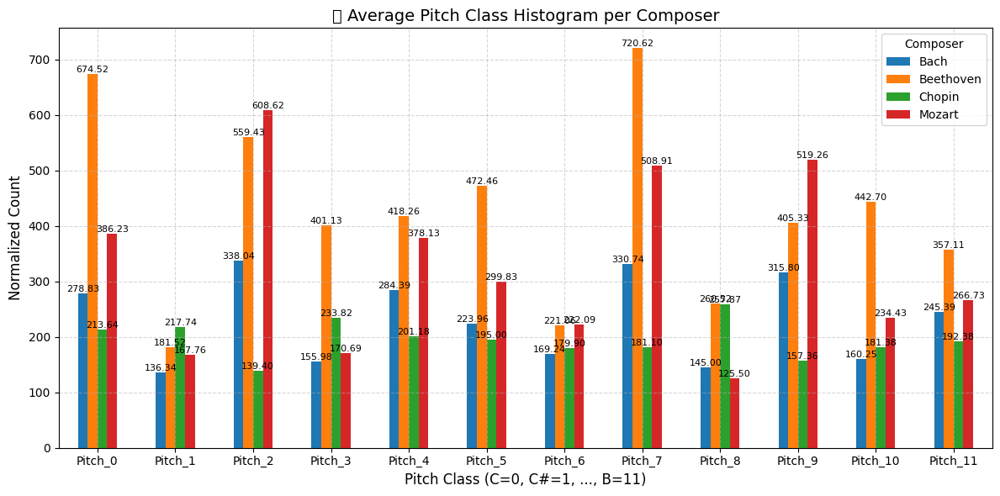

In [100]:
import matplotlib.pyplot as plt
import pandas as pd

# Create DataFrame
df = pd.DataFrame(X, columns=[f"Pitch_{i}" for i in range(12)] + ["Velocity", "Duration", "Density"])
df["Composer"] = y

# Compute mean pitch histogram per composer
composer_means = df.groupby("Composer").mean()

# Plot
ax = composer_means.iloc[:, :12].T.plot(kind="bar", figsize=(12,6))
plt.title("🎼 Average Pitch Class Histogram per Composer", fontsize=14)
plt.xlabel("Pitch Class (C=0, C#=1, ..., B=11)", fontsize=12)
plt.ylabel("Normalized Count", fontsize=12)
plt.xticks(rotation=0)
plt.legend(title="Composer", fontsize=10)
plt.grid(True, linestyle="--", alpha=0.5)

# Add value labels on bars
for container in ax.containers:
    ax.bar_label(container, fmt="%.2f", label_type="edge", fontsize=8)

plt.tight_layout()
plt.show()

Pitch Class in Music and MIDI Files
Pitch class describes all pitches that are a whole number of octaves apart, essentially grouping together notes that share the same name (such as all C notes, all D♯/E♭ notes, etc.), regardless of octave. In the twelve-tone equal temperament system common in Western music, there are 12 pitch classes, one for each semitone:

C, C♯/D♭, D, D♯/E♭, E, F, F♯/G♭, G, G♯/A♭, A, A♯/B♭, B

In MIDI files, each note event has a MIDI note number. The pitch class is found by taking the MIDI note number modulo 12. For example, all MIDI notes with numbers 0, 12, 24, ..., 108 correspond to pitch class C.

Analyzing pitch class content in MIDI allows you to study harmonic structure, chord occurrence, key detection, and compositional style.

Pitch class histograms are often used in music analysis applications.



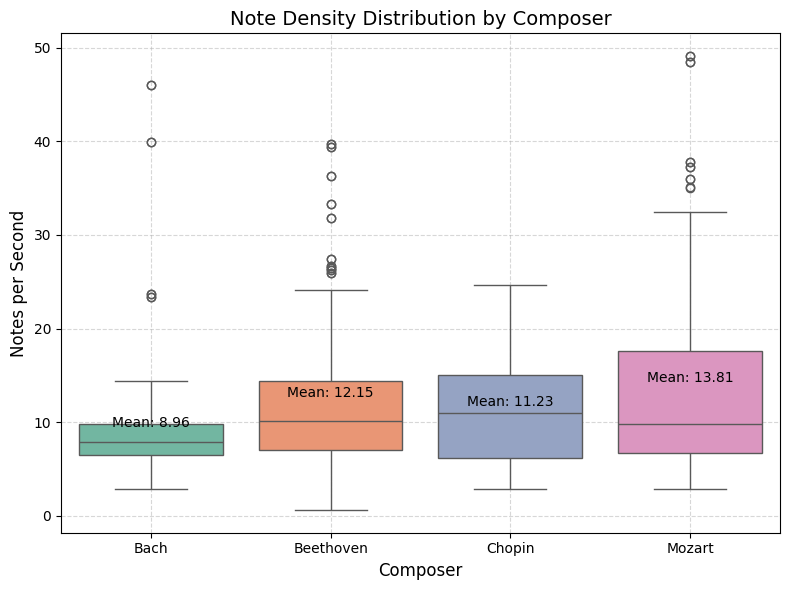

In [102]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8,6))
sns.boxplot(x="Composer", y="Density", hue="Composer", data=df, palette="Set2", legend=False)
plt.title("Note Density Distribution by Composer", fontsize=14)
plt.xlabel("Composer", fontsize=12)
plt.ylabel("Notes per Second", fontsize=12)
plt.grid(True, linestyle="--", alpha=0.5)

# Add mean labels above each box
group_means = df.groupby("Composer")["Density"].mean()
for i, composer in enumerate(group_means.index):
    mean_val = group_means[composer]
    plt.text(i, mean_val + 0.5, f"Mean: {mean_val:.2f}", ha="center", fontsize=10, color="black")

plt.tight_layout()
plt.show()

Note Density in Music and MIDI Files
Note density refers to how many musical notes occur within a particular segment of time or space in a piece of music. In music theory and audio analysis, this is often expressed as the number of notes per measure, per beat, or per second. High note density means more notes are played within the same duration, while low note density means fewer notes.

In MIDI files, note density is frequently computed as the total number of MIDI note-on events within a selected time window (e.g., per measure, per bar, per second).

Note density influences musical texture and perceived complexity and is often used as a feature in music information retrieval (MIR) and generative systems.

Example: If a MIDI file contains 64 notes played in one 4/4 measure, its note density is much higher than another file with only 8 notes in the same duration.

Ref: https://arxiv.org/pdf/2407.01499



In [ ]:
https://arxiv.org/pdf/2407.01499


In [81]:
def extract_features(path):
    midi = pretty_midi.PrettyMIDI(path)
    notes = [note for inst in midi.instruments for note in inst.notes]
    pitch_hist = np.histogram([n.pitch % 12 for n in notes], bins=12, range=(0,12))[0]
    velocity_mean = np.mean([n.velocity for n in notes])
    duration_mean = np.mean([n.end - n.start for n in notes])
    note_density = len(notes) / midi.get_end_time()
    return np.concatenate([pitch_hist, [velocity_mean, duration_mean, note_density]])

In [82]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

X = [extract_features(p) for p in midi_paths]
y = [composer_to_label[c] for c in composer_list]

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2)
clf = RandomForestClassifier(n_estimators=100)
clf.fit(X_train, y_train)
print("Accuracy:", clf.score(X_test, y_test))

/usr/local/lib/python3.11/dist-packages/pretty_midi/pretty_midi.py:100: RuntimeWarning:

Tempo, Key or Time signature change events found on non-zero tracks.  This is not a valid type 0 or type 1 MIDI file.  Tempo, Key or Time Signature may be wrong.



KeySignatureError: Could not decode key with 2 flats and mode 2

In [ ]:
importances = clf.feature_importances_
plt.bar(range(len(importances)), importances)
plt.title("Feature Importance")
plt.show()

In [59]:
root_dir = base_path  # Adjust to your actual path
midi_paths, composer_list = collect_midi_metadata(root_dir)

plot_work_count_seaborn(composer_list)
plot_total_duration_seaborn(midi_paths, composer_list)

FileNotFoundError: [Errno 2] No such file or directory: 'midiclassics'

In [78]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def plot_work_count_seaborn(composer_list):
    df = pd.DataFrame({'Composer': composer_list})
    plt.figure(figsize=(8, 5))

    ax = sns.countplot(x='Composer', hue='Composer', data=df, palette="Set2", legend=True)

    # Add count labels on top of each bar
    for p in ax.patches:
        height = p.get_height()
        ax.annotate(f'{height}',
                    (p.get_x() + p.get_width() / 2., height),
                    ha='center', va='bottom',
                    fontsize=10, color='black',
                    xytext=(0, 5), textcoords='offset points')

    plt.title("Number of MIDI Works per Composer")
    plt.xlabel("Composer")
    plt.ylabel("Count")
    plt.grid(axis='y', linestyle='--', alpha=0.4)
    plt.tight_layout()
    plt.show()

In [72]:
from mido.midifiles.meta import KeySignatureError
import pretty_midi
import warnings
from collections import defaultdict

def get_total_durations(midi_paths, composer_list):
    duration_dict = defaultdict(float)
    bad_files = []

    for path, composer in zip(midi_paths, composer_list):
        try:
            with warnings.catch_warnings():
                warnings.simplefilter("ignore", RuntimeWarning)
                midi = pretty_midi.PrettyMIDI(path)
                duration_dict[composer] += midi.get_end_time()
        except (OSError, IOError, ValueError, IndexError, KeySignatureError) as e:
            bad_files.append((path, str(e)))

    if bad_files:
        print(f"\n⚠️ Skipped {len(bad_files)} invalid MIDI files:")
        for path, err in bad_files[:5]:
            print(f"  - {path}: {err}")
        if len(bad_files) > 5:
            print("  ...and more.")

    return duration_dict

# to handle keysignature error
# from mido, triggered when it tries to decode a MIDI file’s key signature and encounters an invalid mode value (mode = 255), which is outside the expected range (0 for major, 1 for minor)

def get_total_durations(midi_paths, composer_list):
    from collections import defaultdict
    import warnings
    import pretty_midi

    duration_dict = defaultdict(float)
    bad_files = []

    for path, composer in zip(midi_paths, composer_list):
        try:
            with warnings.catch_warnings():
                warnings.simplefilter("ignore", RuntimeWarning)
                midi = pretty_midi.PrettyMIDI(path)
                duration_dict[composer] += midi.get_end_time()
        except (OSError, IOError, ValueError, IndexError) as e:
            bad_files.append((path, str(e)))
    
    if bad_files:
        print(f"\n⚠️ Skipped {len(bad_files)} invalid MIDI files:")
        for path, err in bad_files[:5]:
            print(f"  - {path}: {err}")
        if len(bad_files) > 5:
            print("  ...and more.")

    return duration_dict

In [ ]:
root_dir = 'midiclassics'  # Adjust to your actual path
midi_paths, composer_list = collect_midi_metadata(root_dir)

plot_work_count_seaborn(composer_list)
plot_total_duration_seaborn(midi_paths, composer_list)

/tmp/ipython-input-1159131153.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




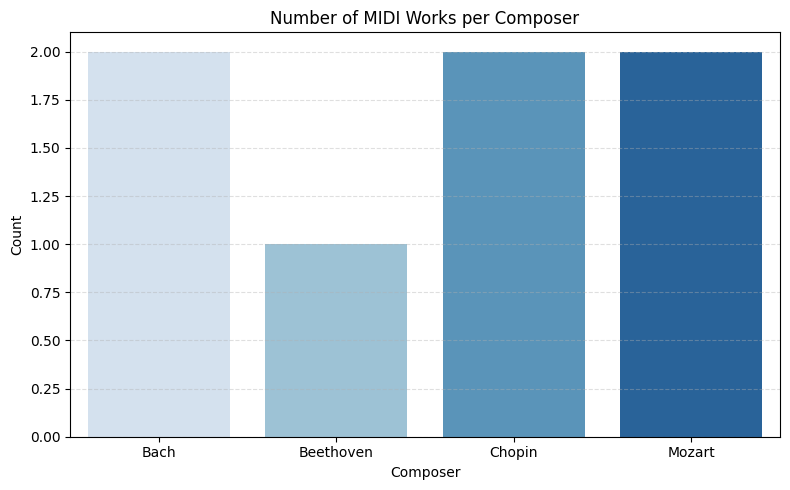

FileNotFoundError: [Errno 2] No such file or directory: 'data/bach1.mid'

In [58]:
plot_work_count_seaborn(composer_list)
plot_total_duration_seaborn(midi_paths, composer_list)

In [48]:
def shift_pitch(piano_roll, semitones):
    shifted = np.roll(piano_roll, semitones, axis=0)
    return shifted

#Midi as structured representation


In [45]:
def midi_to_pianoroll(path, fs=100):
    pm = pretty_midi.PrettyMIDI(path)
    piano_roll = pm.get_piano_roll(fs=fs)  # shape: (128, T)
    return piano_roll


*   Normalization and Padding


In [46]:
def preprocess_roll(piano_roll, max_length=500):
    piano_roll = piano_roll.T  # shape: (T, 128)
    if piano_roll.shape[0] < max_length:
        pad_width = max_length - piano_roll.shape[0]
        piano_roll = np.pad(piano_roll, ((0, pad_width), (0, 0)))
    else:
        piano_roll = piano_roll[:max_length]
    return piano_roll.T  # back to (128, T)

Label Encoding
*    Mapping coposer to integer labels for classification

In [47]:
composer_to_label = {name: idx for idx, name in enumerate(target_composers)}
labeled_data = [(path, composer_to_label[composer]) for path, composer in composer_files]

In [57]:
X = []
y = []

for path, label in labeled_data:
    piano_roll = midi_to_pianoroll(path)
    piano_roll = piano_roll.T  # shape: (128, T)
    flattened = piano_roll.sum(axis=1)  # shape: (128,)
    X.append(flattened)
    y.append(label)

X = np.array(X)
y = np.array(y)

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

plt.figure(figsize=(8,6))
for i, composer in enumerate(target_composers):
    plt.scatter(X_pca[y==i, 0], X_pca[y==i, 1], label=composer)
plt.legend()
plt.title("Composer Clusters via PCA (Selected Only)")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.grid(True)
plt.show()

/usr/local/lib/python3.11/dist-packages/pretty_midi/pretty_midi.py:100: RuntimeWarning:

Tempo, Key or Time signature change events found on non-zero tracks.  This is not a valid type 0 or type 1 MIDI file.  Tempo, Key or Time Signature may be wrong.



KeySignatureError: Could not decode key with 3 flats and mode 255

In [ ]:
from torch.utils.data import Dataset
import torch

class ComposerMIDIDataset(Dataset):
    def __init__(self, labeled_data, fs=100, max_length=500):
        self.data = labeled_data
        self.fs = fs
        self.max_length = max_length

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        path, label = self.data[idx]
        piano_roll = midi_to_pianoroll(path, fs=self.fs).T  # (128, T)
        if piano_roll.shape[1] < self.max_length:
            pad_width = self.max_length - piano_roll.shape[1]
            piano_roll = np.pad(piano_roll, ((0, 0), (0, pad_width)))
        else:
            piano_roll = piano_roll[:, :self.max_length]
        piano_roll = torch.tensor(piano_roll, dtype=torch.float32)
        return piano_roll, label

Break

/usr/local/lib/python3.11/dist-packages/pretty_midi/pretty_midi.py:100: RuntimeWarning:

Tempo, Key or Time signature change events found on non-zero tracks.  This is not a valid type 0 or type 1 MIDI file.  Tempo, Key or Time Signature may be wrong.



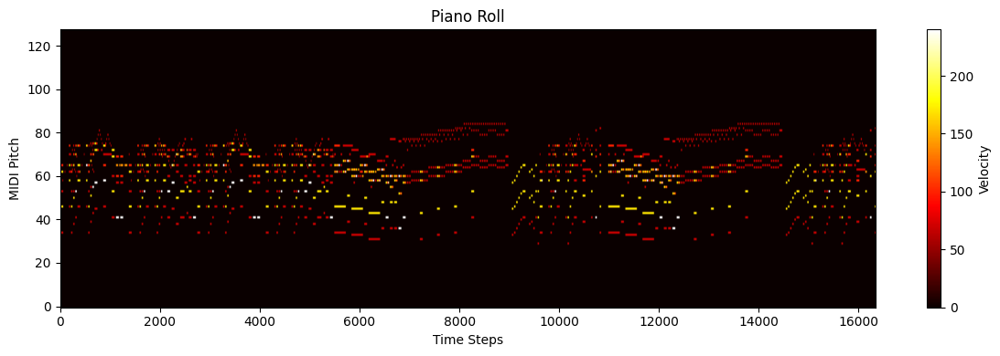

In [32]:
import pretty_midi
import matplotlib.pyplot as plt

def midi_to_pianoroll(path, fs=100):
    midi = pretty_midi.PrettyMIDI(path)
    piano_roll = midi.get_piano_roll(fs=fs)
    return piano_roll.T  # Shape: (time_steps, 128)

# Load and visualize
if midi_files:
    sample_file = midi_files[0]
    piano_roll = midi_to_pianoroll(sample_file)

    plt.figure(figsize=(12, 4))
    plt.imshow(piano_roll.T, aspect='auto', origin='lower', cmap='hot')
    plt.title("Piano Roll")
    plt.xlabel("Time Steps")
    plt.ylabel("MIDI Pitch")
    plt.colorbar(label="Velocity")
    plt.tight_layout()
    plt.show()
else:
    print("No MIDI files found.")

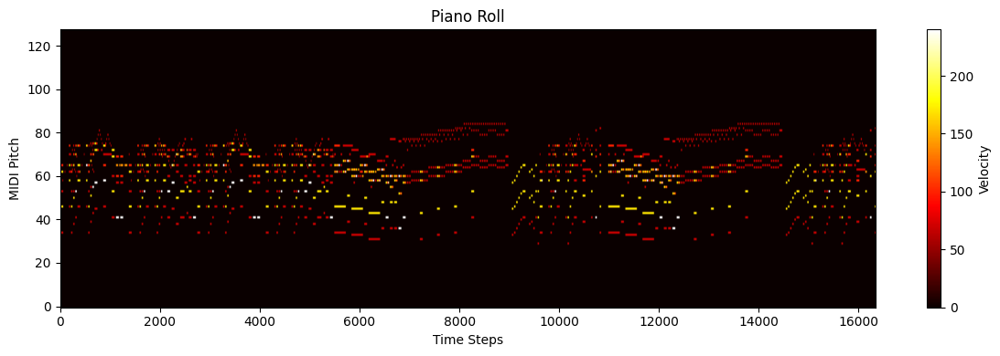

In [33]:
import pretty_midi
import matplotlib.pyplot as plt

def midi_to_pianoroll(path, fs=100):
    midi = pretty_midi.PrettyMIDI(path)
    piano_roll = midi.get_piano_roll(fs=fs)
    return piano_roll.T  # Shape: (time_steps, 128)

# Load and visualize
if midi_files:
    sample_file = midi_files[0]
    piano_roll = midi_to_pianoroll(sample_file)

    plt.figure(figsize=(12, 4))
    plt.imshow(piano_roll.T, aspect='auto', origin='lower', cmap='hot')
    plt.title("Piano Roll")
    plt.xlabel("Time Steps")
    plt.ylabel("MIDI Pitch")
    plt.colorbar(label="Velocity")
    plt.tight_layout()
    plt.show()
else:
    print("No MIDI files found.")

In [34]:
import plotly.graph_objects as go

def plot_piano_roll_plotly(piano_roll, fs=100):
    time_steps = piano_roll.shape[0]
    duration = time_steps / fs
    time_axis = np.linspace(0, duration, time_steps)
    pitch_axis = np.arange(128)

    fig = go.Figure(data=go.Heatmap(
        z=piano_roll.T,  # Transpose to (pitch, time)
        x=time_axis,
        y=pitch_axis,
        colorscale='Hot',
        colorbar=dict(title='Velocity'),
        hovertemplate='Time: %{x:.2f}s<br>Pitch: %{y}<br>Velocity: %{z}<extra></extra>'
    ))

    fig.update_layout(
        title="🎼 MIDI Piano Roll (Interactive)",
        xaxis_title="Time (s)",
        yaxis_title="MIDI Pitch",
        yaxis=dict(autorange="reversed"),  # MIDI pitch goes high to low
        height=600
    )

    fig.show()

In [35]:
sample_file = midi_files[0]  # Or any file from your list
piano_roll = midi_to_pianoroll(sample_file)
plot_piano_roll_plotly(piano_roll)

Train a Composer Classifier
Use the piano roll representations to train a CNN or Transformer-based model to predict the composer.
- Input: Piano roll (128 pitches × time steps)
- Output: One of 4 composer labels
- Loss: Cross-entropy
- Metric: Accuracy, F1-score
This could reveal which composers are most distinguishable based on note patterns and rhythm.


In [37]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Assume piano_rolls is a list of flattened piano rolls
X = np.array(piano_roll)
y = np.array(labels)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

plt.figure(figsize=(8,6))
for i, composer in enumerate(target_composers):
    plt.scatter(X_pca[y==i, 0], X_pca[y==i, 1], label=composer)
plt.legend()
plt.title("Composer Clusters via PCA")
plt.show()

NameError: name 'labels' is not defined

In [19]:
!pip install kaggle
!kaggle datasets download -d blanderbuss/midi-classic-music


Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 10, in <module>
    sys.exit(main())
             ^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/kaggle/cli.py", line 68, in main
    out = args.func(**command_args)
          ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/kaggle/api/kaggle_api_extended.py", line 1741, in dataset_download_cli
    with self.build_kaggle_client() as kaggle:
         ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/kaggle/api/kaggle_api_extended.py", line 688, in build_kaggle_client
    username=self.config_values['username'],
             ~~~~~~~~~~~~~~~~~~^^^^^^^^^^^^
KeyError: 'username'


In [12]:
!unzip midi-classic-music.zip -d ./midi_data

unzip:  cannot find or open midi-classic-music.zip, midi-classic-music.zip.zip or midi-classic-music.zip.ZIP.


In [10]:
import os

midi_dir = "./midi_data"
print("Top-level contents:", os.listdir(midi_dir))

# Recursively find .mid files
midi_files = []
for root, _, files in os.walk(midi_dir):
    for file in files:
        if file.endswith(".mid"):
            midi_files.append(os.path.join(root, file))

print(f"Found {len(midi_files)} MIDI files.")

FileNotFoundError: [Errno 2] No such file or directory: './midi_data'

In [11]:
import os

midi_dir = "/kaggle/input/midi-classic-music"

# List top-level contents
print("Top-level contents:")
print(os.listdir(midi_dir))


Top-level contents:


FileNotFoundError: [Errno 2] No such file or directory: '/kaggle/input/midi-classic-music'

In [ ]:
import librosa

def audio_to_melspectrogram(path, sr=22050, n_mels=128):
    y, _ = librosa.load(path, sr=sr)
    mel = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=n_mels)
    mel_db = librosa.power_to_db(mel, ref=np.max)
    return mel_db

# Example
mel_spec = audio_to_melspectrogram('./audio_samples/humming.wav')